## 基础作业2
[作业二说明](https://github.com/open-mmlab/OpenMMLabCamp/blob/main/AI%20%E5%AE%9E%E6%88%98%E8%90%A5%E5%9F%BA%E7%A1%80%E7%8F%AD/%E4%BD%9C%E4%B8%9A%E4%BA%8C_mmdetection.md)


## 1. Balloon数据集
balloon是带有mask的气球数据集，其中训练集包含61张图片，验证集包含13张图片。
下载链接：https://github.com/matterport/Mask_RCNN/releases/download/v2.1/balloon_dataset.zip

In [1]:
# !pip install openmim
# !mim install mmdet

import torch
import mmcv
import mmdet  #AssertionError: MMCV==2.0.0rc3 is used but incompatible. Please install mmcv>=1.3.17, <=1.8.0.

In [2]:
print(torch.__version__,mmcv.__version__,mmdet.__version__)
# print(torch.__version__,mmcv.__version__)

1.6.0 2.0.0rc3 3.0.0rc5


In [6]:
# download the pretrained model with smallest size
!mim download mmdet --config mask-rcnn_r50_fpn_2x_coco --dest .

processing mask-rcnn_r50_fpn_2x_coco...
downloading ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 169.6/169.6 MiB 11.8 MB/s eta 0:00:0000:0100:01
Successfully downloaded mask_rcnn_r50_fpn_2x_coco_bbox_mAP-0.392__segm_mAP-0.354_20200505_003907-3e542a40.pth to /home/cine/mmcls1/mmdetection
Successfully dumped mask-rcnn_r50_fpn_2x_coco.py to /home/cine/mmcls1/mmdetection


In [4]:
# generate coco format json
!python balloon2CoCoFormat3.py

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 61/61, 46.9 task/s, elapsed: 1s, ETA:     0s
[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 13/13, 50.7 task/s, elapsed: 0s, ETA:     0s


In [3]:
# Test model before retraining
from mmdet.apis import init_detector,inference_detector # ,show_result_pyplot
from mmdet.utils import register_all_modules

config_file = 'mask-rcnn_r50_fpn_2x_coco.py'
checkpoint_file = 'mask_rcnn_r50_fpn_2x_coco_bbox_mAP-0.392__segm_mAP-0.354_20200505_003907-3e542a40.pth'
register_all_modules()
model0 = init_detector(config_file,checkpoint_file,device='cpu')

/home/cine/miniconda3/envs/mmlab2/lib/python3.8/site-packages/mmengine/model/utils.py:138: UserWarning: Cannot import torch.fx, `merge_dict` is a simple function to merge multiple dicts
  warnings.warn('Cannot import torch.fx, `merge_dict` is a simple function '


02/12 18:41:05 - mmengine - WARNING - The "model" registry in mmdet did not set import location. Fallback to call `mmdet.utils.register_all_modules` instead.
02/12 18:41:05 - mmengine - WARNING - The "task util" registry in mmdet did not set import location. Fallback to call `mmdet.utils.register_all_modules` instead.
Loads checkpoint by local backend from path: mask_rcnn_r50_fpn_2x_coco_bbox_mAP-0.392__segm_mAP-0.354_20200505_003907-3e542a40.pth
02/12 18:41:06 - mmengine - WARNING - The "dataset" registry in mmdet did not set import location. Fallback to call `mmdet.utils.register_all_modules` instead.
02/12 18:41:06 - mmengine - WARNING - The "transform" registry in mmdet did not set import location. Fallback to call `mmdet.utils.register_all_modules` instead.


In [4]:
from mmdet.registry import VISUALIZERS

# init the visualizer(execute this block only once)
visualizer = VISUALIZERS.build(model0.cfg.visualizer)
# the dataset_meta is loaded from the checkpoint and
# then pass to the model in init_detector
visualizer.dataset_meta = model0.dataset_meta

02/12 18:41:13 - mmengine - WARNING - The "visualizer" registry in mmdet did not set import location. Fallback to call `mmdet.utils.register_all_modules` instead.


/home/cine/miniconda3/envs/mmlab2/lib/python3.8/site-packages/mmengine/visualization/visualizer.py:163: UserWarning: `Visualizer` backend is not initialized because save_dir is None.
  warnings.warn('`Visualizer` backend is not initialized '


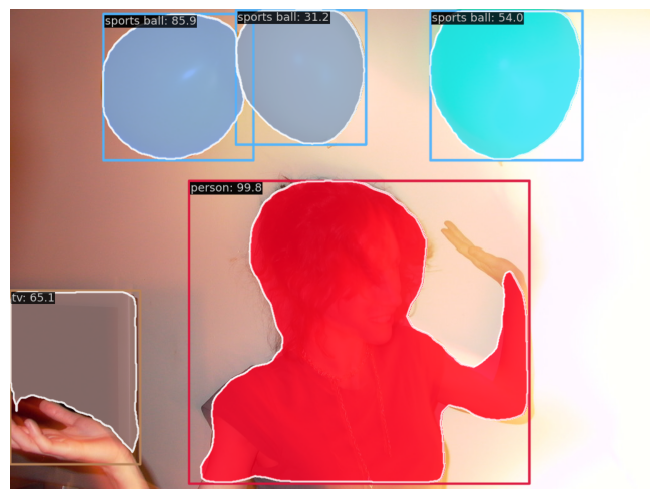

In [5]:
image_path = './data/balloon/val/410488422_5f8991f26e_b.jpg'

img = mmcv.imread( image_path, channel_order='rgb')
result = inference_detector(model0,img)

# show the results
visualizer.add_datasample(
    'result',
    img,
    data_sample=result,
    draw_gt=False,
    wait_time=0,
)
visualizer.show()

In [6]:
! python tools/train.py \
    mask_rcnn_r50_fpn_2x_coco_balloon3.py \
    --work-dir work_dirs/mask_rcnn_r50_fpn_2x_coco_balloon3

/home/cine/miniconda3/envs/mmlab2/lib/python3.8/site-packages/mmengine/model/utils.py:138: UserWarning: Cannot import torch.fx, `merge_dict` is a simple function to merge multiple dicts
  warnings.warn('Cannot import torch.fx, `merge_dict` is a simple function '
02/12 18:42:20 - mmengine - WARNING - The "log_processor" registry in mmdet did not set import location. Fallback to call `mmdet.utils.register_all_modules` instead.
02/12 18:42:21 - mmengine - INFO - 
------------------------------------------------------------
System environment:
    sys.platform: linux
    Python: 3.8.16 (default, Jan 17 2023, 23:13:24) [GCC 11.2.0]
    CUDA available: True
    numpy_random_seed: 1865434603
    GPU 0: NVIDIA GeForce GTX 1080 Ti
    CUDA_HOME: /home/cine/miniconda3/envs/mmlab2
    NVCC: Cuda compilation tools, release 11.6, V11.6.124
    GCC: gcc (Ubuntu 11.3.0-1ubuntu1~22.04) 11.3.0
    PyTorch: 1.6.0
    PyTorch compiling details: PyTorch built with:
  - GCC 7.3
  - C++ Version: 201402
  - 

Loads checkpoint by local backend from path: work_dirs/mask_rcnn_r50_fpn_2x_coco_balloon3/epoch_24.pth


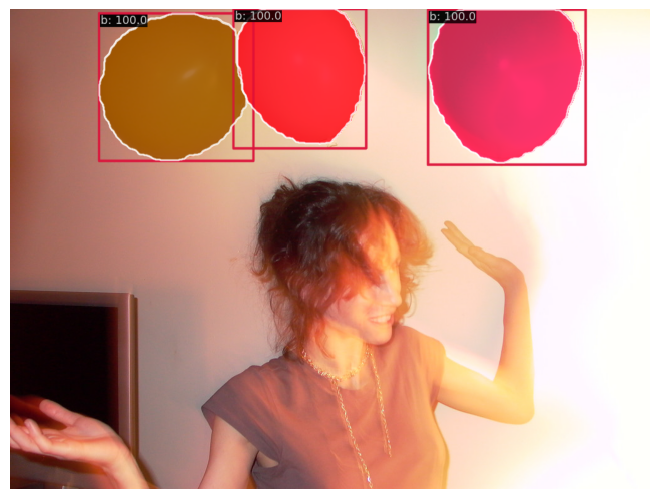

In [8]:
config_file_retrain = 'mask_rcnn_r50_fpn_2x_coco_balloon3.py'
checkpoint_file_retrain = 'work_dirs/mask_rcnn_r50_fpn_2x_coco_balloon3/epoch_24.pth'

model = init_detector(config_file_retrain,checkpoint_file_retrain,device='cpu')

result_retrain = inference_detector(model,img)
visualizer.dataset_meta = model.dataset_meta   # set the visualizer metadata when you changed your dataset

# show the results
visualizer.add_datasample(
    'result',
    img,
    data_sample=result_retrain,
    draw_gt=False,
    wait_time=0,
)
visualizer.show()


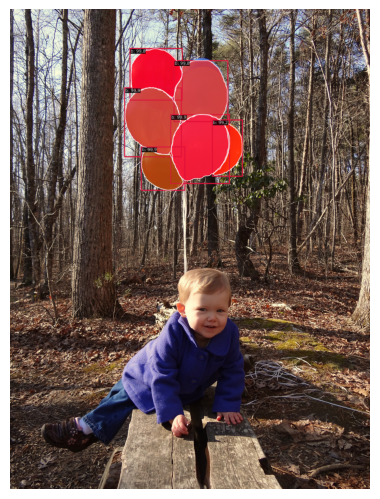

In [9]:
image_path2 = 'data/balloon/val/16335852991_f55de7958d_k.jpg'
img2 = mmcv.imread( image_path2, channel_order='rgb')
result_retrain2 = inference_detector(model,img2)

# show the results
visualizer.add_datasample(
    'result',
    img2,
    data_sample=result_retrain2,
    draw_gt=False,
    wait_time=0,
)
visualizer.show()

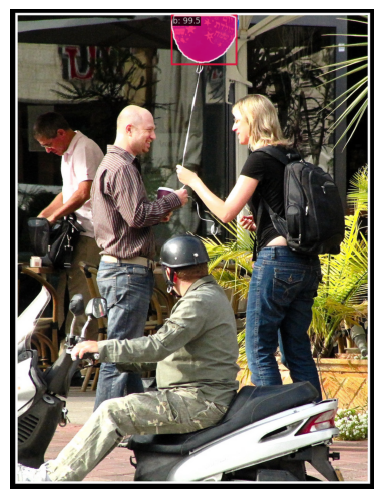

In [35]:
image_path2 = 'data/balloon/val/4581425993_72b9b15fc0_b.jpg'

img2 = mmcv.imread( image_path2, channel_order='rgb')
result_retrain2 = inference_detector(model,img2)

# show the results
visualizer.add_datasample(
    'result',
    img2,
    data_sample=result_retrain2,
    draw_gt=False,
    wait_time=0,
)
visualizer.show()

In [24]:
import numpy as np
# result_retrain_arr =np.array(result_retrain)

def showShape(input_):
    input_arr = np.array(input_)
    print(input_arr.shape)
    # print(input_arr)

# # result_retrain[0]
# # result_retrain[1]
for i in result_retrain:
    showShape(i)
# # (1, 3, 5)
# # (1, 3, 768, 1024)

# np.array(result_retrain[1]).shape   #　(1, 3, 768, 1024)  three channel mask
# result_retrain[0]
# mmcv.imread(image_path, channel_order='rgb').shape  # (768, 1024, 3)

result_retrain[0]  # box*4+score
# [array([[3.6045764e+02, 0.0000000e+00, 5.7187622e+02, 2.1934343e+02,
#          9.9945372e-01],
#         [6.6618005e+02, 1.6541016e-01, 9.1358221e+02, 2.5361465e+02,
#          9.9932182e-01],
#         [1.3965622e+02, 8.4932156e+00, 3.7981638e+02, 2.4632968e+02,
#          9.9929368e-01]], dtype=float32)]

(1, 3, 5)
(1, 3, 768, 1024)


[array([[3.6045764e+02, 0.0000000e+00, 5.7187622e+02, 2.1934343e+02,
         9.9945372e-01],
        [6.6618005e+02, 1.6541016e-01, 9.1358221e+02, 2.5361465e+02,
         9.9932182e-01],
        [1.3965622e+02, 8.4932156e+00, 3.7981638e+02, 2.4632968e+02,
         9.9929368e-01]], dtype=float32)]

In [29]:
result_retrain

<DetDataSample(

    META INFORMATION
    scale_factor: (1.0419921875, 1.0416666666666667)
    img_shape: (800, 1067)
    batch_input_shape: (800, 1088)
    pad_shape: (800, 1088)
    ori_shape: (768, 1024)
    img_path: None
    img_id: 0

    DATA FIELDS
    pred_instances: <InstanceData(
        
            META INFORMATION
        
            DATA FIELDS
            labels: tensor([0, 0, 0, 0, 0, 0])
            masks: tensor([[[False, False, False,  ..., False, False, False],
                         [False, False, False,  ..., False, False, False],
                         [False, False, False,  ..., False, False, False],
                         ...,
                         [False, False, False,  ..., False, False, False],
                         [False, False, False,  ..., False, False, False],
                         [False, False, False,  ..., False, False, False]],
                
                        [[False, False, False,  ..., False, False, False],
              

In [33]:
print(type(result_retrain),'\n',result_retrain.keys())

<class 'mmdet.structures.det_data_sample.DetDataSample'> 
 ['pred_instances', 'ignored_instances', 'gt_instances']


In [36]:
result_retrain.gt_instances.keys()

['labels', 'masks', 'bboxes']

In [37]:
result_retrain.ignored_instances.keys()

['labels', 'masks', 'bboxes']

In [24]:
result_retrain.pred_instances.keys()

['labels', 'masks', 'bboxes', 'scores']

In [27]:
for i in result_retrain.pred_instances.keys():
    print(i,result_retrain.pred_instances[i].shape)
    print(result_retrain.pred_instances[i][:1])
    print()

labels torch.Size([6])
tensor([0])

masks torch.Size([6, 768, 1024])
tensor([[[False, False, False,  ..., False, False, False],
         [False, False, False,  ..., False, False, False],
         [False, False, False,  ..., False, False, False],
         ...,
         [False, False, False,  ..., False, False, False],
         [False, False, False,  ..., False, False, False],
         [False, False, False,  ..., False, False, False]]])

bboxes torch.Size([6, 4])
tensor([[142.3062,   8.3207, 388.7980, 243.8157]])

scores torch.Size([6])
tensor([0.9997])



In [34]:
for i in result_retrain.pred_instances.keys():
    print(i,result_retrain.pred_instances[i].shape)
    # print(result_retrain.pred_instances[i][:1])
    print()

labels torch.Size([6])

masks torch.Size([6, 768, 1024])

bboxes torch.Size([6, 4])

scores torch.Size([6])



In [28]:
for i in result_retrain.gt_instances.keys():
    print(i,result_retrain.pred_instances[i].shape)
    print(result_retrain.pred_instances[i][:1])
    print()

labels torch.Size([6])
tensor([0])

masks torch.Size([6, 768, 1024])
tensor([[[False, False, False,  ..., False, False, False],
         [False, False, False,  ..., False, False, False],
         [False, False, False,  ..., False, False, False],
         ...,
         [False, False, False,  ..., False, False, False],
         [False, False, False,  ..., False, False, False],
         [False, False, False,  ..., False, False, False]]])

bboxes torch.Size([6, 4])
tensor([[142.3062,   8.3207, 388.7980, 243.8157]])



In [18]:
import numpy as np
# result_retrain_arr =np.array(result_retrain)

def showShape(input_):
    input_arr = np.array(input_)
    print(input_arr.shape)
    # print(input_arr)

# # result_retrain[0]
# # result_retrain[1]
for i in result_retrain:
    showShape(i)
# # (1, 3, 5)
# # (1, 3, 768, 1024)

# np.array(result_retrain[1]).shape   #　(1, 3, 768, 1024)  three channel mask
# result_retrain[0]
# mmcv.imread(image_path, channel_order='rgb').shape  # (768, 1024, 3)

result_retrain[0]  # box*4+score
# [array([[3.6045764e+02, 0.0000000e+00, 5.7187622e+02, 2.1934343e+02,
#          9.9945372e-01],
#         [6.6618005e+02, 1.6541016e-01, 9.1358221e+02, 2.5361465e+02,
#          9.9932182e-01],
#         [1.3965622e+02, 8.4932156e+00, 3.7981638e+02, 2.4632968e+02,
#          9.9929368e-01]], dtype=float32)]

TypeError: 'DetDataSample' object is not iterable

In [10]:
# generate test results for test images
!python tools/test.py \
    mask_rcnn_r50_fpn_2x_coco_balloon3.py \
    work_dirs/mask_rcnn_r50_fpn_2x_coco_balloon3/epoch_24.pth \
    --show-dir show

/home/cine/miniconda3/envs/mmlab2/lib/python3.8/site-packages/mmengine/model/utils.py:138: UserWarning: Cannot import torch.fx, `merge_dict` is a simple function to merge multiple dicts
  warnings.warn('Cannot import torch.fx, `merge_dict` is a simple function '
02/12 18:49:33 - mmengine - WARNING - The "log_processor" registry in mmdet did not set import location. Fallback to call `mmdet.utils.register_all_modules` instead.
02/12 18:49:33 - mmengine - INFO - 
------------------------------------------------------------
System environment:
    sys.platform: linux
    Python: 3.8.16 (default, Jan 17 2023, 23:13:24) [GCC 11.2.0]
    CUDA available: True
    numpy_random_seed: 614904520
    GPU 0: NVIDIA GeForce GTX 1080 Ti
    CUDA_HOME: /home/cine/miniconda3/envs/mmlab2
    NVCC: Cuda compilation tools, release 11.6, V11.6.124
    GCC: gcc (Ubuntu 11.3.0-1ubuntu1~22.04) 11.3.0
    PyTorch: 1.6.0
    PyTorch compiling details: PyTorch built with:
  - GCC 7.3
  - C++ Version: 201402
  - I

In [15]:
# # generate test results for test images
# !python tools/test.py \
#     mask_rcnn_r50_fpn_2x_coco_balloon3.py \
#     work_dirs/mask_rcnn_r50_fpn_2x_coco_balloon3/epoch_24.pth \
#     --show-dir show2 \
#     --show-score-thr 90
#
#
# # import torch.fx, `merge_dict` is a simple function to merge multiple dicts
# #   warnings.warn('Cannot import torch.fx, `merge_dict` is a simple function '
# # usage: test.py [-h] [--work-dir WORK_DIR] [--out OUT] [--show]
# #                [--show-dir SHOW_DIR] [--wait-time WAIT_TIME]
# #                [--cfg-options CFG_OPTIONS [CFG_OPTIONS ...]]
# #                [--launcher {none,pytorch,slurm,mpi}] [--local_rank LOCAL_RANK]
# #                config checkpoint
# # test.py: error: unrecognized arguments: --show-score-thr 90

In [1]:
# generate visualization with test results for test images
import matplotlib.pyplot as plt
import os
import cv2

path_name = r'work_dirs/new3/20230212_175536/show'
num = 1

# plt.rcParams['figure.dpi'] = 300
plt.figure(figsize=(25,35),dpi=300)
for item in os.listdir(path=path_name):
    # img = cv2.imread(os.path.join(path_name,item))#[:,:, ::-1]
    img = cv2.imread(os.path.join(path_name,item))[:,:, ::-1]
    # img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    plt.subplot(7,2,num)
    num+=1
    plt.imshow(img)
    plt.title(item)
    plt.xticks([])
    plt.yticks([])
    # break
plt.savefig("work_dirs/new3/20230212_175536/result7x2_25_35.png")
plt.show()


In [52]:
# generate result.mp4 with trained model and test_video.mp4
!python video3.py \
    --output_path result.mp4 \
    test_video.mp4 \
    mask_rcnn_r50_fpn_2x_coco_balloon3.py \
    work_dirs/mask_rcnn_r50_fpn_2x_coco_balloon3/epoch_24.pth
    # --output_path2 test_video_gt.mp4 \

/home/cine/miniconda3/envs/mmlab2/lib/python3.8/site-packages/mmengine/model/utils.py:138: UserWarning: Cannot import torch.fx, `merge_dict` is a simple function to merge multiple dicts
  warnings.warn('Cannot import torch.fx, `merge_dict` is a simple function '
02/12 21:38:40 - mmengine - WARNING - The "model" registry in mmdet did not set import location. Fallback to call `mmdet.utils.register_all_modules` instead.
02/12 21:38:40 - mmengine - WARNING - The "task util" registry in mmdet did not set import location. Fallback to call `mmdet.utils.register_all_modules` instead.
Loads checkpoint by local backend from path: work_dirs/mask_rcnn_r50_fpn_2x_coco_balloon3/epoch_24.pth
02/12 21:38:41 - mmengine - WARNING - The "dataset" registry in mmdet did not set import location. Fallback to call `mmdet.utils.register_all_modules` instead.
/home/cine/miniconda3/envs/mmlab2/lib/python3.8/site-packages/mmengine/dataset/base_dataset.py:501: UserWarning: balloon is not a meta file, simply parsed

In [48]:
result.pred_instances.scores.numpy(),result.pred_instances.scores[0]

(array([0.99838305, 0.85916036, 0.65062916, 0.5403771 , 0.31220037,
        0.18796745, 0.10219406, 0.09249002, 0.08700147, 0.07086968,
        0.06580309, 0.06291567], dtype=float32),
 tensor(0.9984))

 # generate gif with mp4 video

In [ ]:
# to show the results, convert the mp4 to gif
!pip install moviepy
!pip install ez_setup

In [78]:
from moviepy.editor import VideoFileClip
videoClip = VideoFileClip("result.mp4")
videoClip.write_gif("result.gif")   # 150M too big

# since the generated gif is too big, I use online website to convert the mp4 videos to gifs.

MoviePy - Building file result.gif with imageio.


# Several methods for mp4 displaying

In [77]:
# this works but open the video outside

import cv2
import numpy as np

# Create a VideoCapture object and read from input file
# If the input is the camera, pass 0 instead of the video file name
cap = cv2.VideoCapture('result.mp4')

# Check if camera opened successfully
if (cap.isOpened()== False):
  print("Error opening video stream or file")

# Read until video is completed
while(cap.isOpened()):
  # Capture frame-by-frame
  ret, frame = cap.read()
  if ret == True:

    # Display the resulting frame
    cv2.imshow('Frame',frame)

    # Press Q on keyboard to  exit
    if cv2.waitKey(25) & 0xFF == ord('q'):
      break

  # Break the loop
  else:
    break

# When everything done, release the video capture object
cap.release()

# Closes all the frames
cv2.destroyAllWindows()

In [75]:
from IPython.display import Video
Video('result.mp4')

In [37]:
from IPython.display import HTML

HTML("""
    <video alt="test" controls>
        <source src="result.mp4" type="video/mp4">
    </video>
""")

In [76]:
from IPython.display import HTML
from base64 import b64encode

def play(filename):
    html = ''
    video = open(filename,'rb').read()
    src = 'data:video/mp4;base64,' + b64encode(video).decode()
    html += '<video width=1000 controls autoplay loop><source src="%s" type="video/mp4"></video>' % src
    return HTML(html)

play('result.mp4')